This is an ipynb file for the scientific study of forest damage-bark beetle detection using remote sensing in Latvia - 
This file was used to mask the shadows in an ortophoto of the study area

In [ ]:
import rasterio #https://github.com/rasterio/rasterio
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import time
import cv2
plt.rcParams['figure.dpi'] = 300

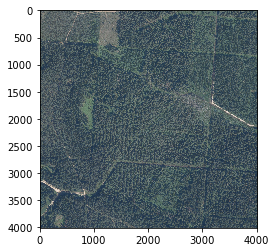

In [2]:
test_path = "D:/Projekti/ZPD\QGIS/LGIA data/3334-42_3 roi/" + "VIS_clipped.tif"
test = rasterio.open(test_path)
img = test.read()
img = np.moveaxis(img, 0, 2) #tranfsorms into wanted shape
plt.figure(figsize=(20,4))
plt.imshow(img)

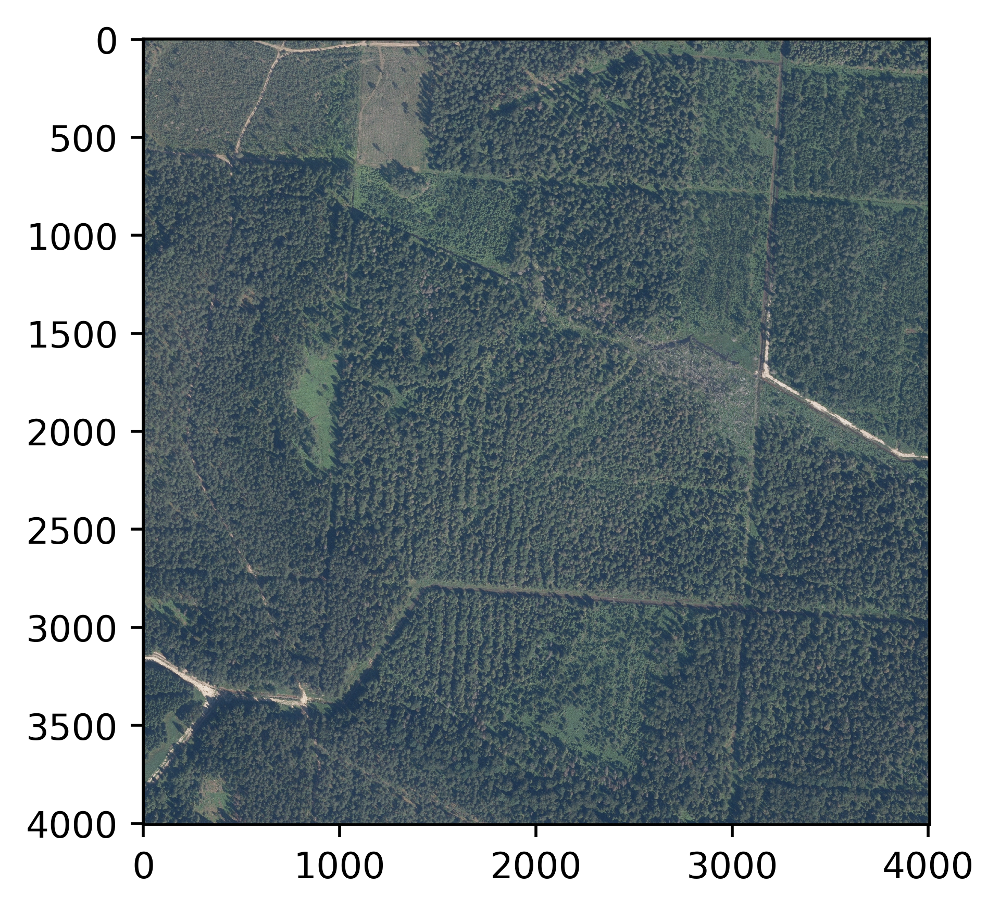

In [3]:
plt.rcParams['figure.dpi'] = 500
plt.imshow(img)

In [4]:
red = test.read(1)
green = test.read(1)
blue = test.read(1)

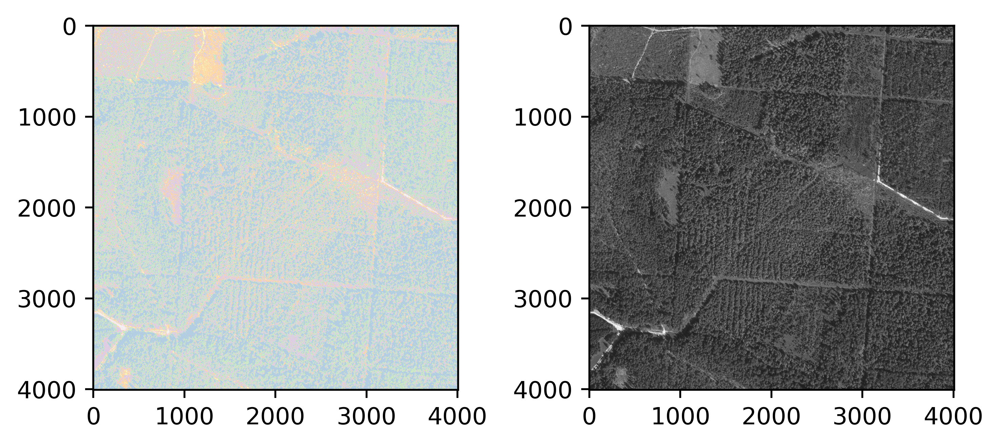

In [5]:
fig, subplot = plt.subplots(nrows=1, ncols=2)
plt.figure(1)
subplot[0].imshow(blue, cmap = "Pastel1")
subplot[1].imshow(blue, cmap = "gray")
plt.tight_layout()
plt.savefig("green.png")

In [6]:
'''
From this we can conclude that the threshold is somewhere from 56-84

We will try to filter shadows with the blue band
'''

'\nFrom this we can conclude that the threshold is somewhere from 56-84\n\nWe will try to filter shadows with the blue band\n'

In [7]:
ret, mask56 = cv2.threshold(blue, 56, 255, cv2.THRESH_BINARY)
ret, mask63 = cv2.threshold(blue, 63, 255, cv2.THRESH_BINARY)
ret, mask70 = cv2.threshold(blue, 70, 255, cv2.THRESH_BINARY)
ret, mask77 = cv2.threshold(blue, 77, 255, cv2.THRESH_BINARY)
ret, mask84 = cv2.threshold(blue, 84, 255, cv2.THRESH_BINARY)

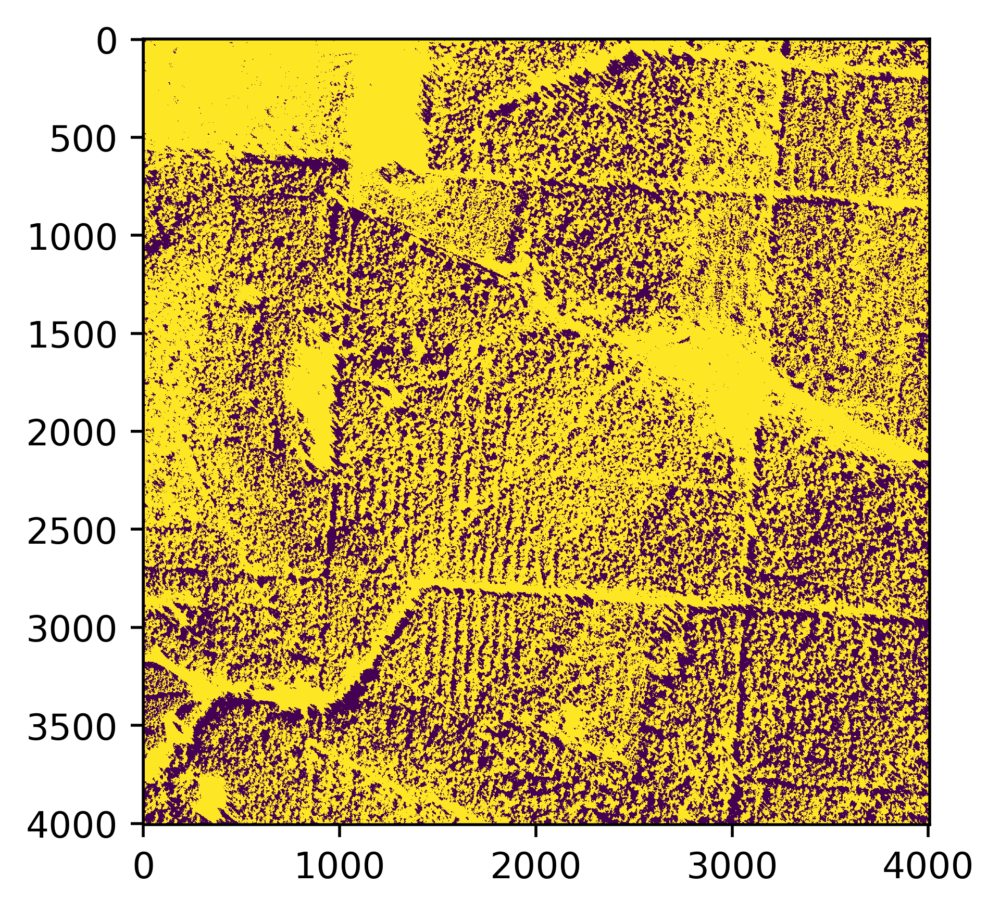

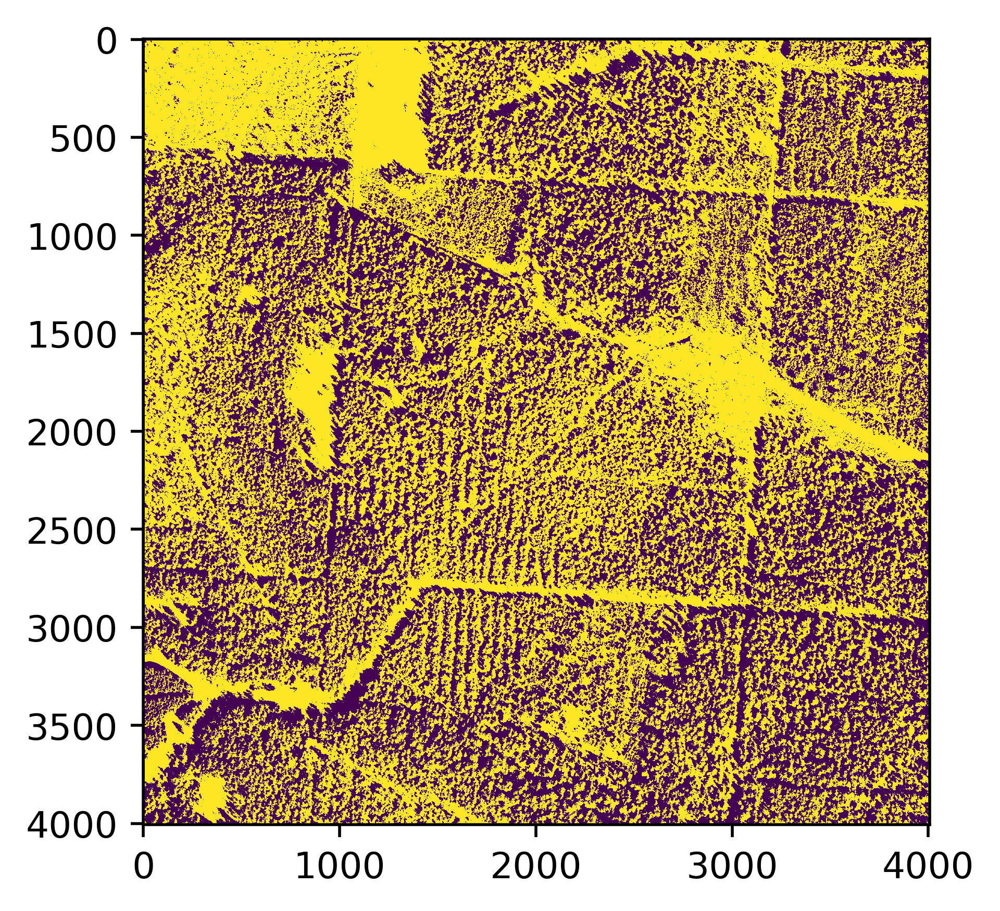

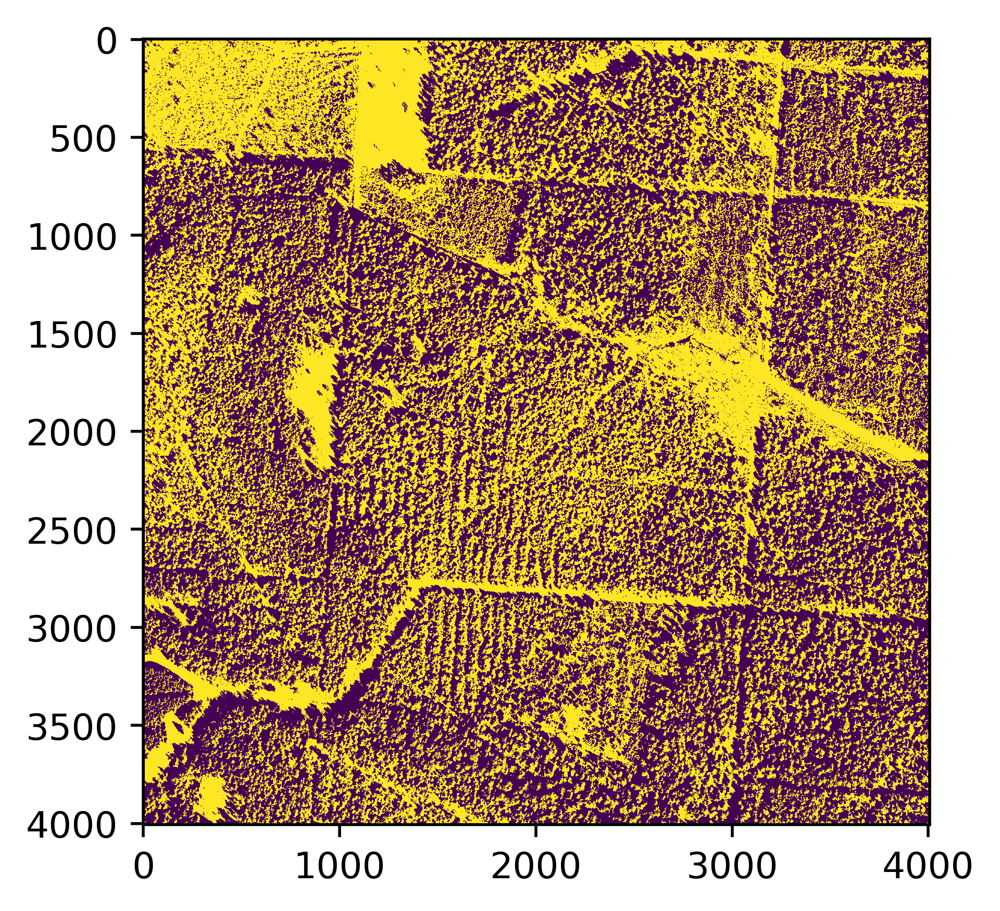

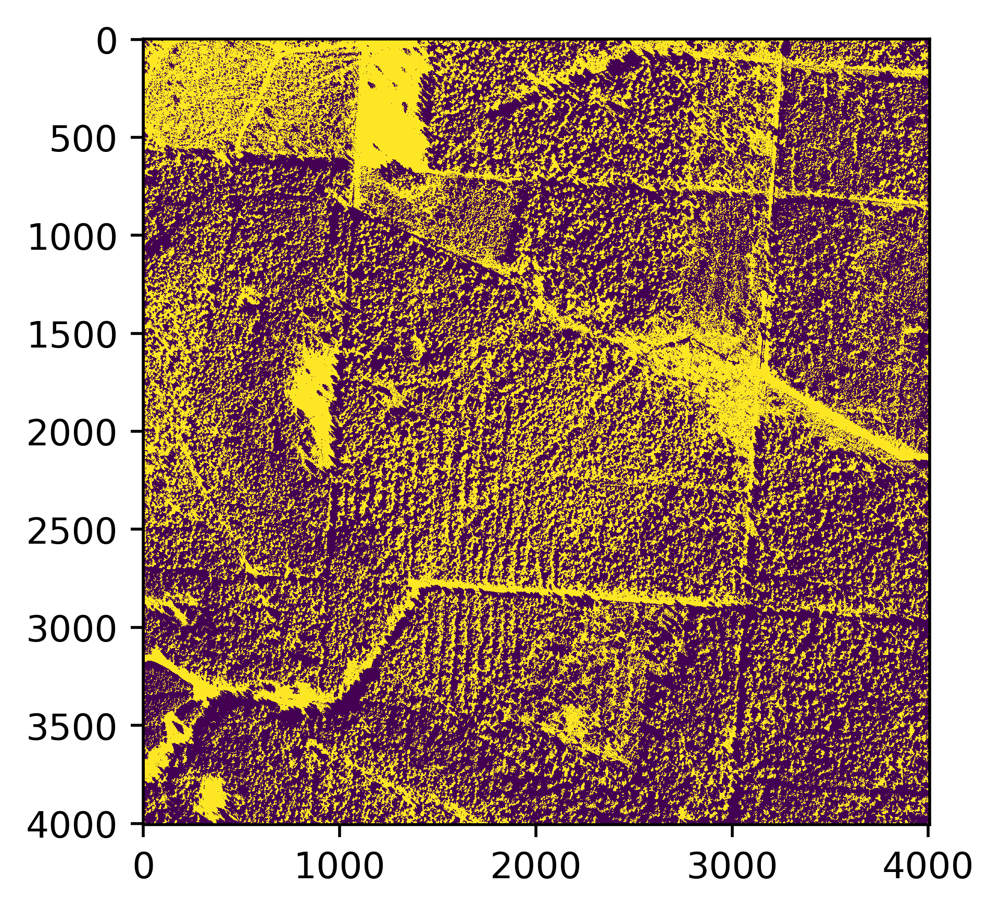

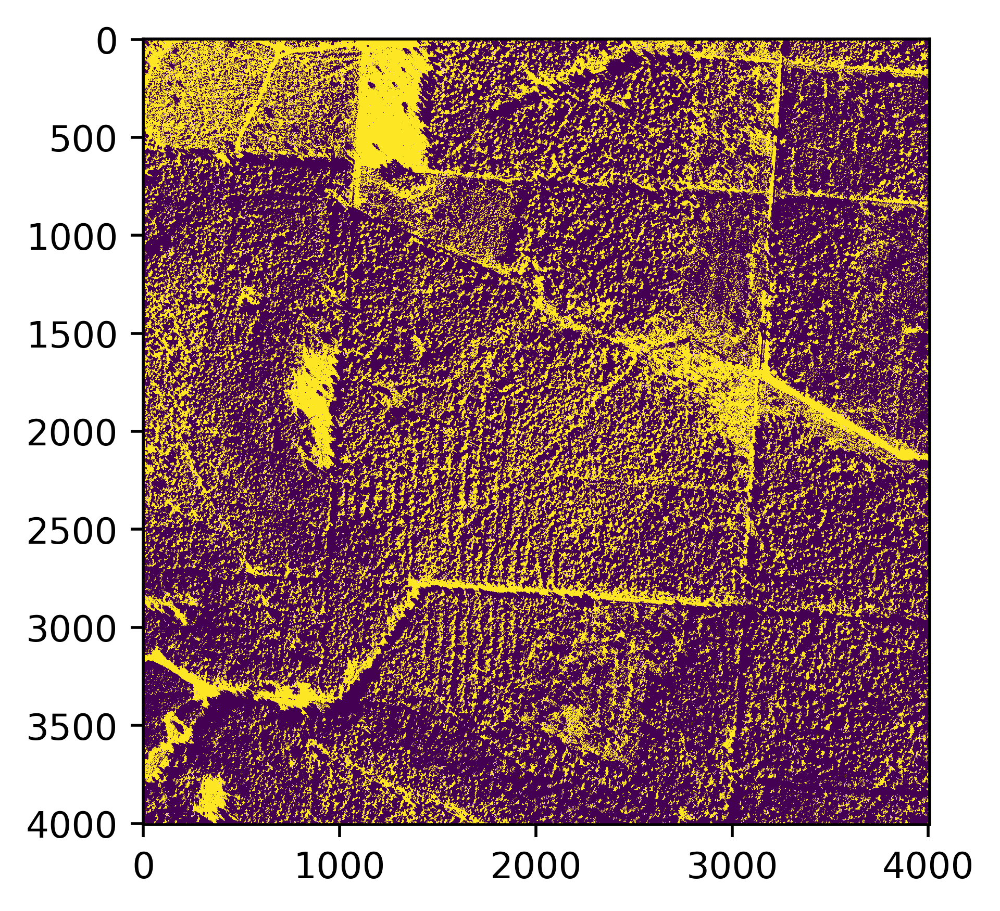

In [8]:
plt.figure(1)
plt.imshow(mask56)
plt.figure(2)
plt.imshow(mask63)
plt.figure(3)
plt.imshow(mask70)
plt.figure(4)
plt.imshow(mask77)
plt.figure(5)
plt.imshow(mask84)

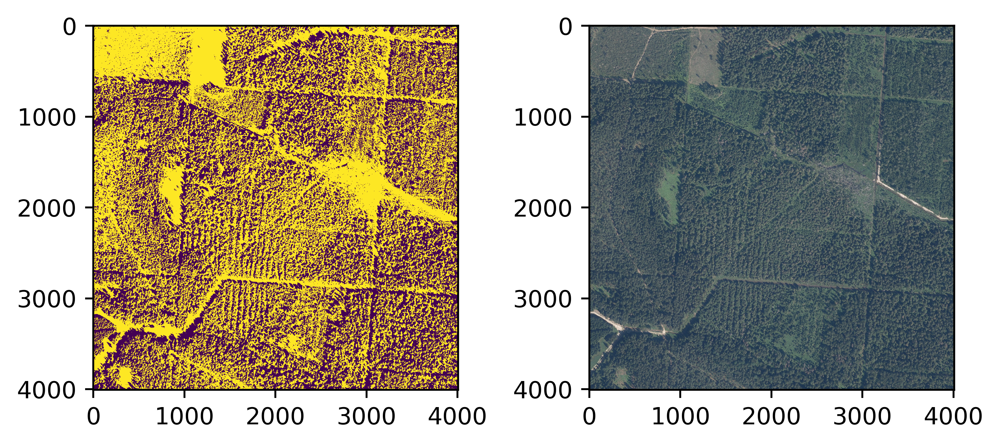

In [9]:
fig, subplot = plt.subplots(nrows=1, ncols=2)
subplot[0].imshow(mask63)
subplot[1].imshow(img)
plt.tight_layout()
plt.savefig("mask63.png")

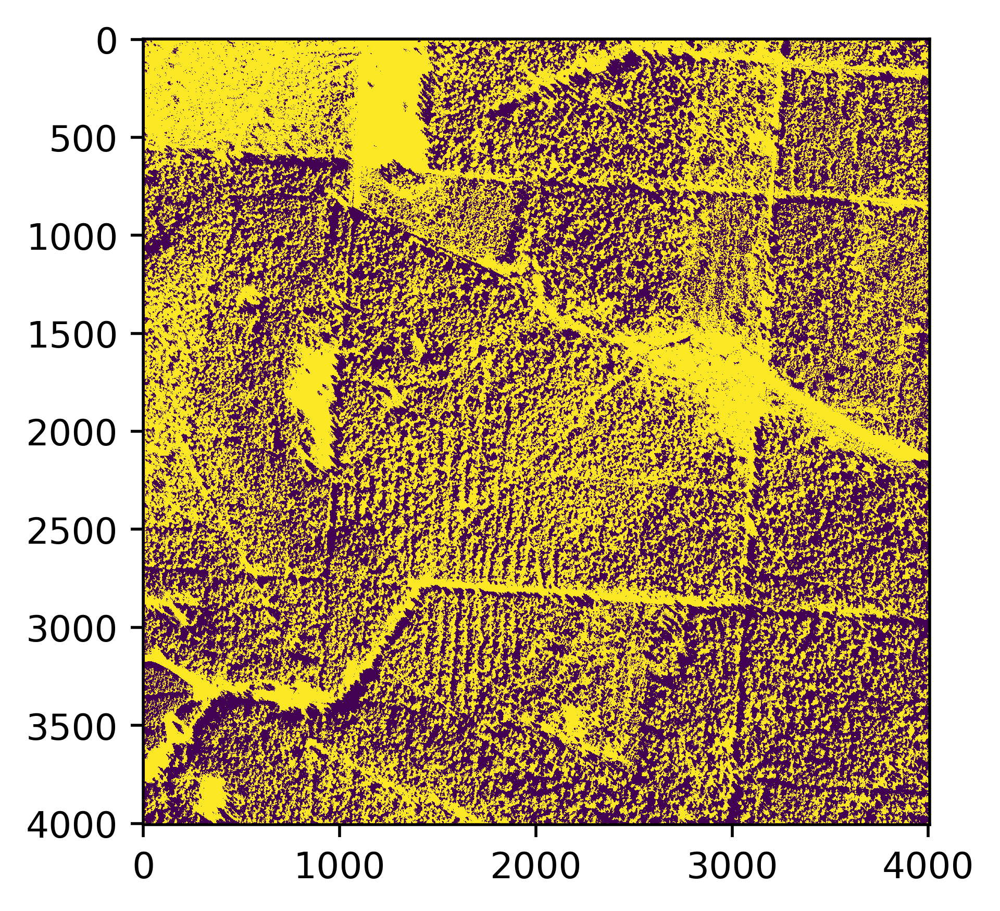

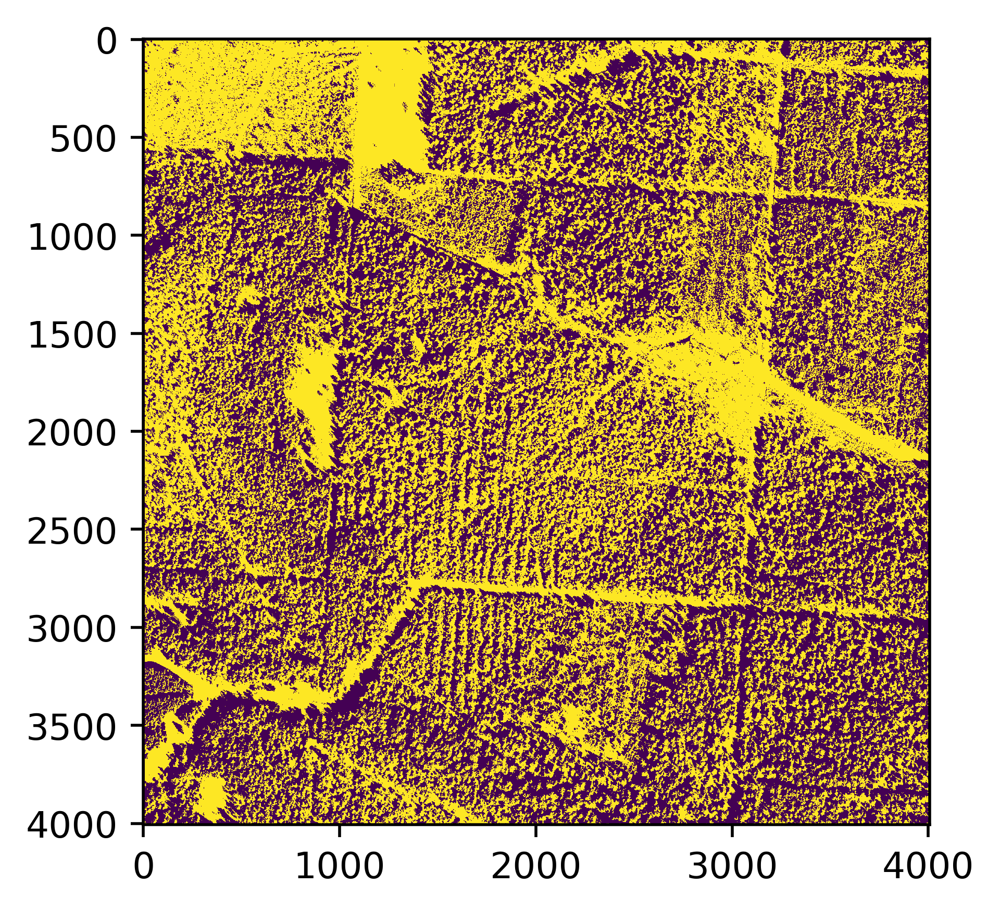

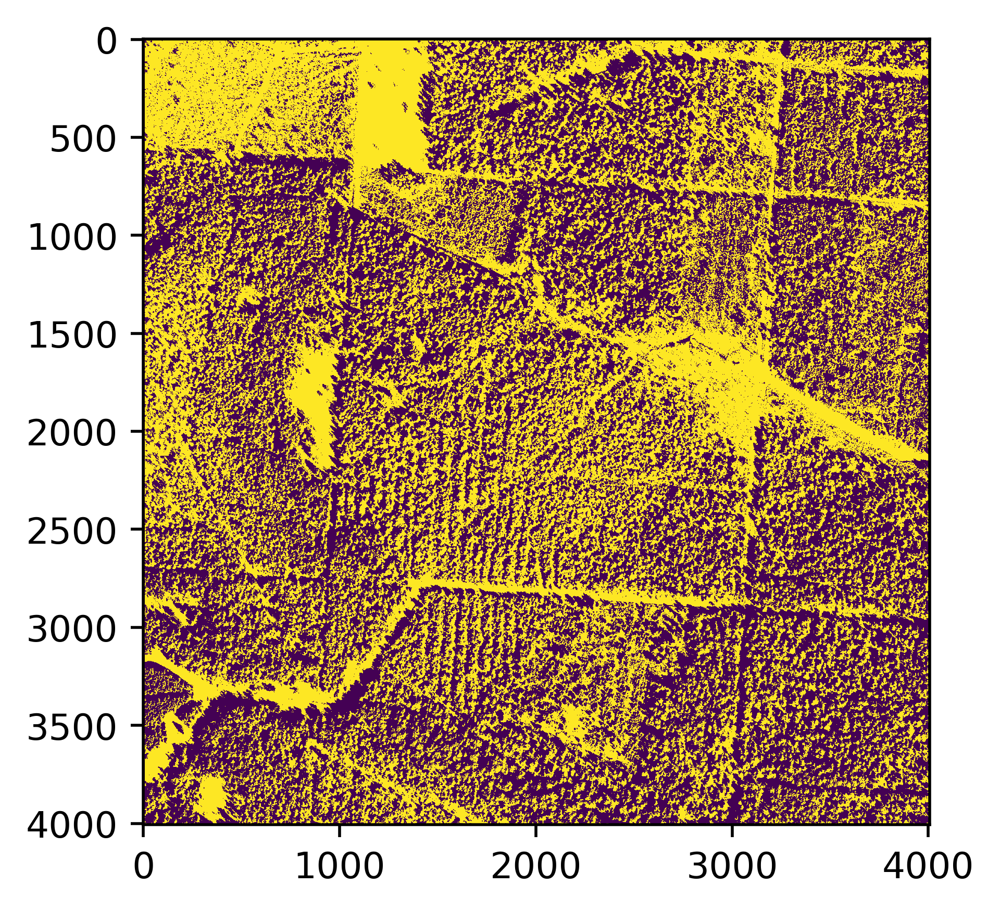

In [10]:
'''
The threshold value is somewhere in the region 63-70
'''
ret, mask65 = cv2.threshold(blue, 65, 255, cv2.THRESH_BINARY)
ret, mask67 = cv2.threshold(blue, 67, 255, cv2.THRESH_BINARY)
ret, mask69 = cv2.threshold(blue, 69, 255, cv2.THRESH_BINARY)

plt.figure(1)
plt.imshow(mask65)
plt.figure(2)
plt.imshow(mask67)
plt.figure(3)
plt.imshow(mask69)

In [11]:
'''
Settled on 67 for now
'''

'\nSettled on 67 for now\n'

In [12]:
masked67 = img.copy()
comp67 = img.copy()
masked67[mask67==0] = 0
comp67[:2000,:,:] = masked67[:2000,:,:]

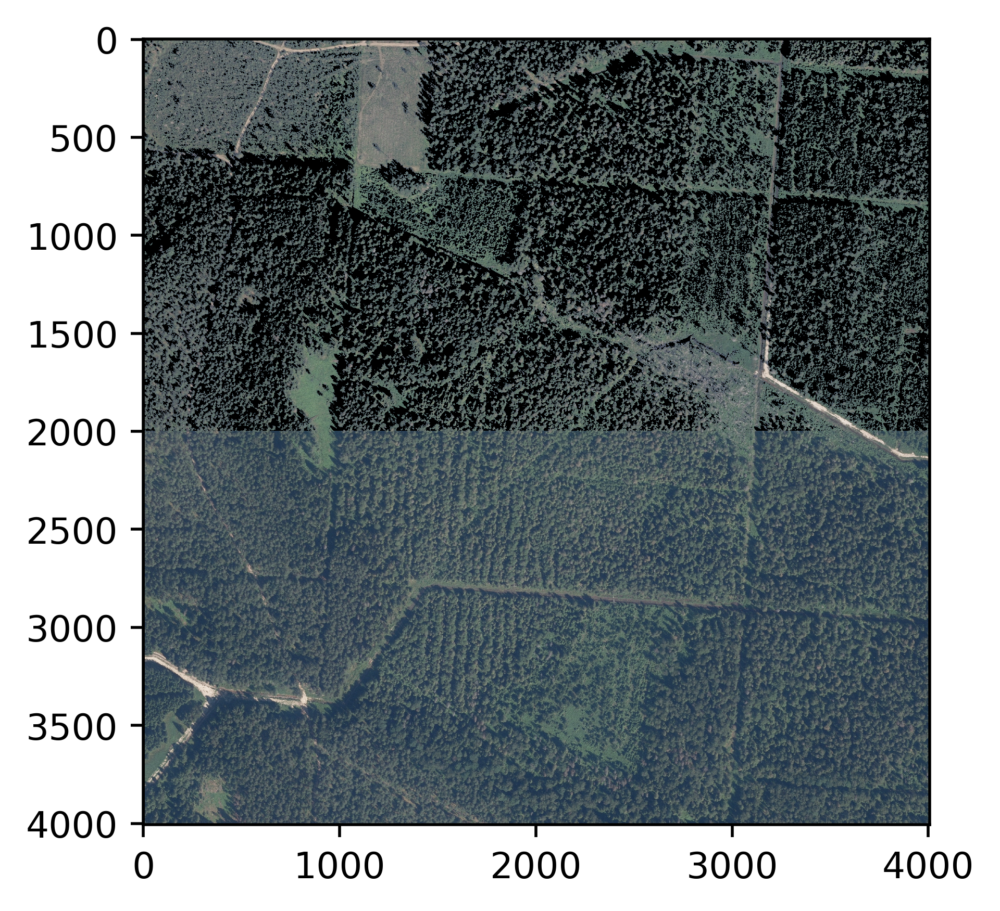

In [14]:
plt.imshow(comp67)
plt.savefig("comp67")

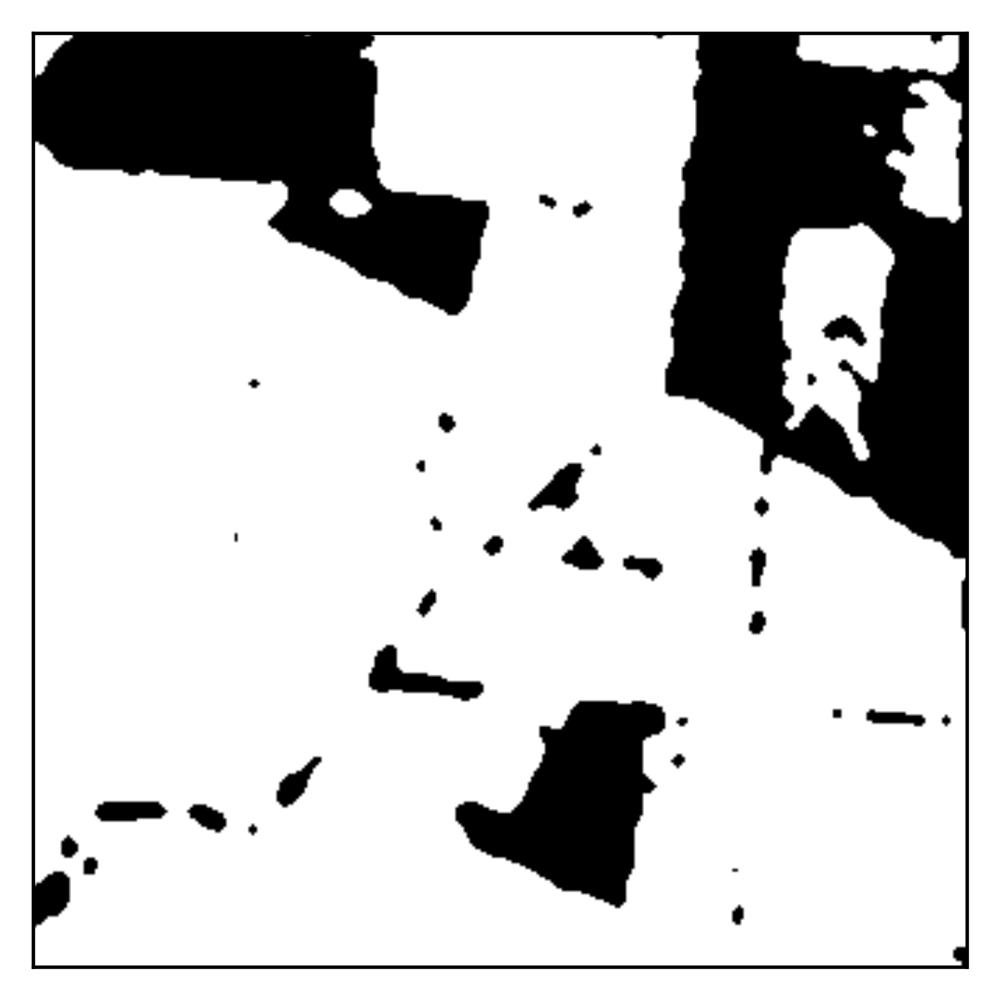

In [20]:
#Saving images for paper

fig = plt.imshow(mask67, cmap = "gray")
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.savefig("bw_mask.png")


fig = plt.imshow(masked67)
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.savefig("masked67_no_ax.png")

tif = rasterio.open("lasmask.tif")
lasmask = tif.read(1)
fig = plt.imshow(lasmask, cmap = "gray")
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.savefig("lasmask.png")

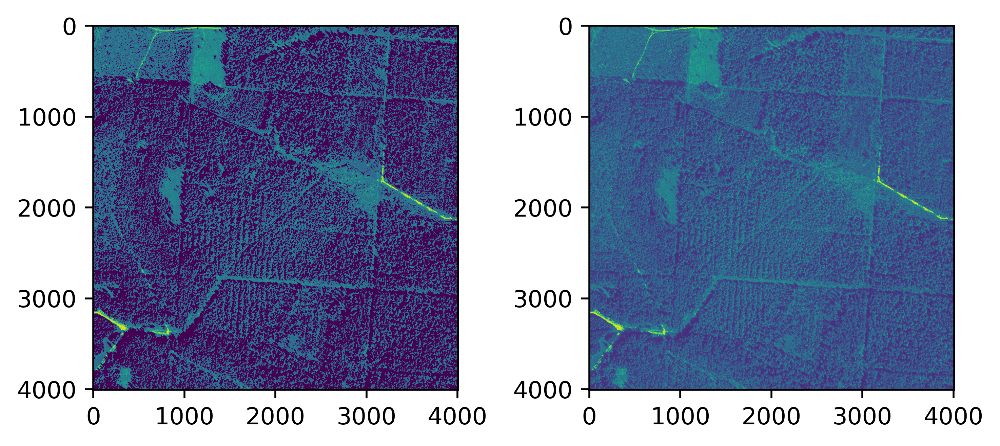

In [43]:
fig, subplot = plt.subplots(nrows=1, ncols=2)
subplot[0].imshow(masked67[:,:,0])
subplot[1].imshow(img[:,:,0])
plt.tight_layout()

In [37]:
'''
Let's say I'm pleased with masked67
'''


"\nLet's say I'm pleased with masked65\n"

In [44]:
masked_bgr = cv2.cvtColor(masked67.copy(), cv2.COLOR_RGB2BGR)
cv2.imwrite("masked67.png", masked_bgr)

True

In [62]:
'''
Now to save the image in a raster file
'''

'\nNow to save the image in a raster file\n'

In [45]:
from osgeo import gdal
filepath = "D:/Projekti/ZPD\QGIS/LGIA data/3334-42_3 roi/" + "VIS_clipped.tif"
ds = gdal.Open(filepath)
gt = ds.GetGeoTransform()
proj = ds.GetProjection()
print(gt, "\n", proj)

(529998.0, 0.25, 0.0, 294000.0, 0.0, -0.25) 
 PROJCS["LKS92 / Latvia TM",GEOGCS["LKS92",DATUM["Latvia_1992",SPHEROID["GRS 1980",6378137,298.257222101,AUTHORITY["EPSG","7019"]],TOWGS84[0,0,0,0,0,0,0],AUTHORITY["EPSG","6661"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4661"]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",0],PARAMETER["central_meridian",24],PARAMETER["scale_factor",0.9996],PARAMETER["false_easting",500000],PARAMETER["false_northing",-6000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AUTHORITY["EPSG","3059"]]


In [46]:
driver = gdal.GetDriverByName("GTiff")
driver.Register()

2

In [47]:
outds = driver.Create("mask67.tif", xsize = mask67.shape[1],
                      ysize = mask67.shape[0], bands = 1, 
                      eType = gdal.GDT_Int16)
outds.SetGeoTransform(gt)
outds.SetProjection(proj)

0

In [48]:
outband1 = outds.GetRasterBand(1)
outband1.WriteArray(mask67)
outband1.SetNoDataValue(np.nan)
outband1.FlushCache()
outband1 = None
outds = None

In [49]:
'''
Test whether successful
'''

'\nTest whether successful\n'

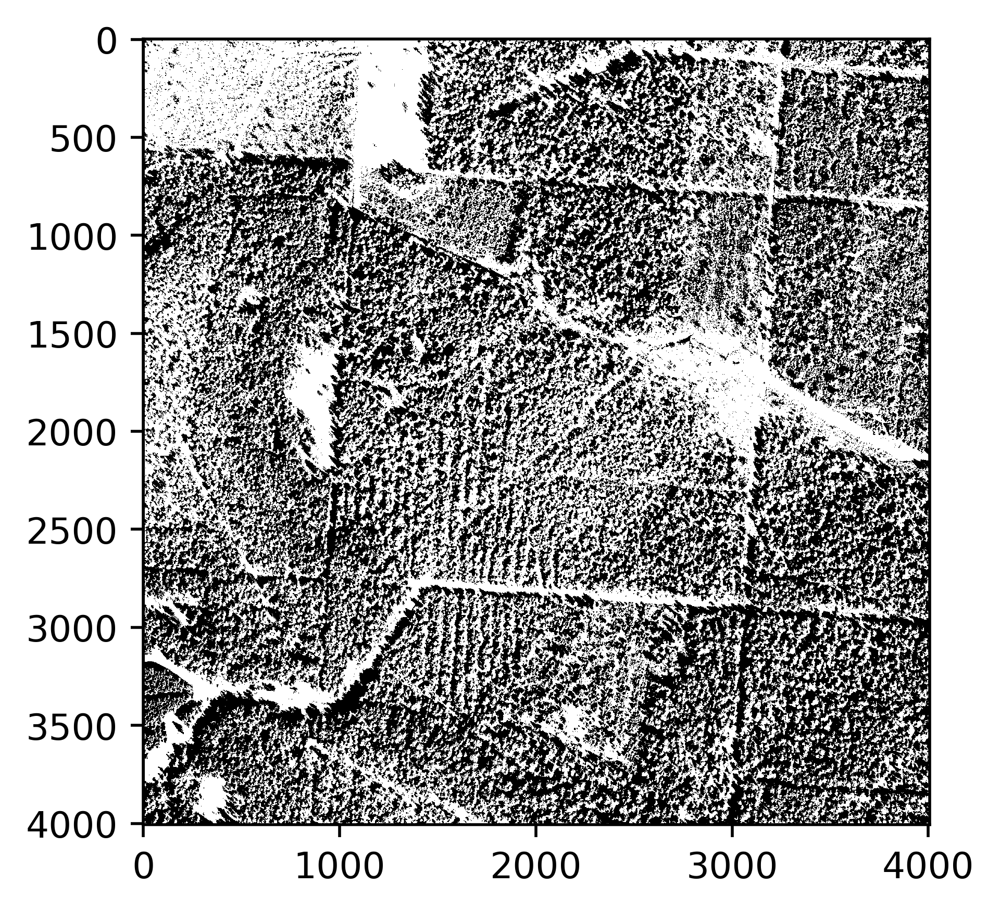

In [50]:
tif = rasterio.open("mask67.tif")
mask68_tif = tif.read(1)
plt.imshow(mask68_tif, cmap = "gray")

### Creating Full mask

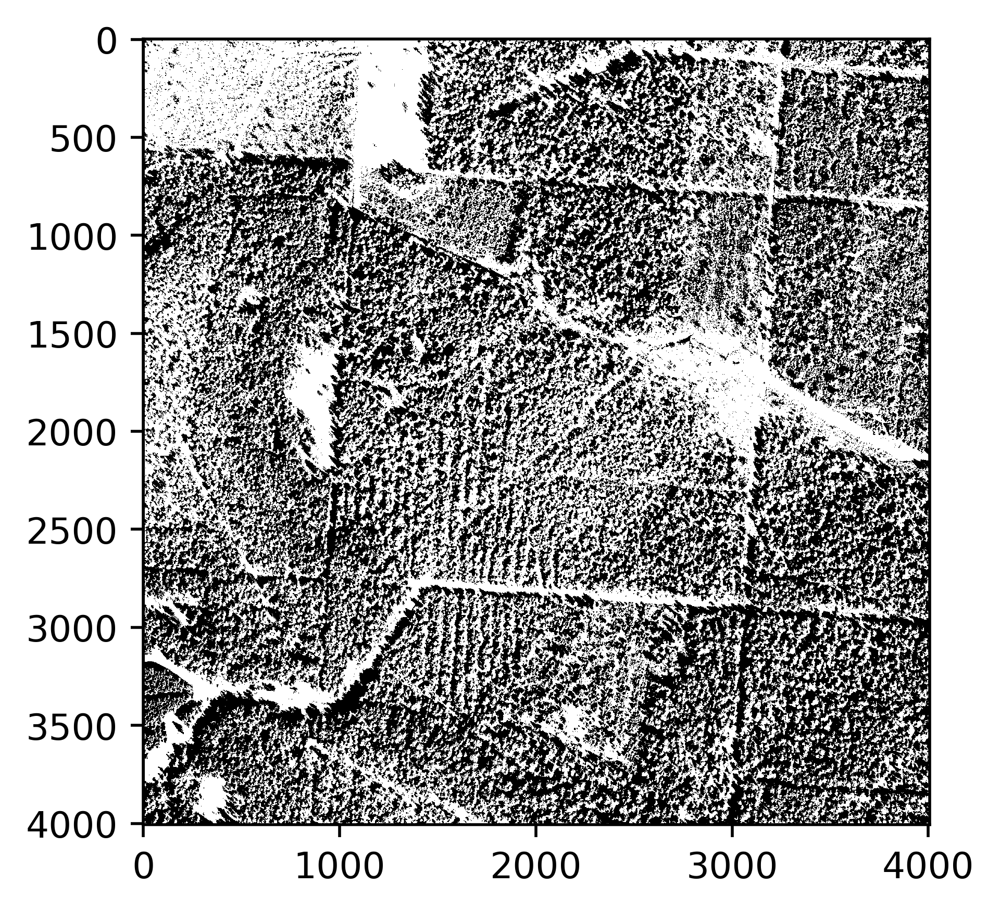

In [26]:
lastif = rasterio.open("lasmask.tif")
las = lastif.read(1)
plt.imshow(las, cmap = "gray")
shadtif = rasterio.open("mask67.tif")
shad = shadtif.read(1)
plt.imshow(shad, cmap = "gray")

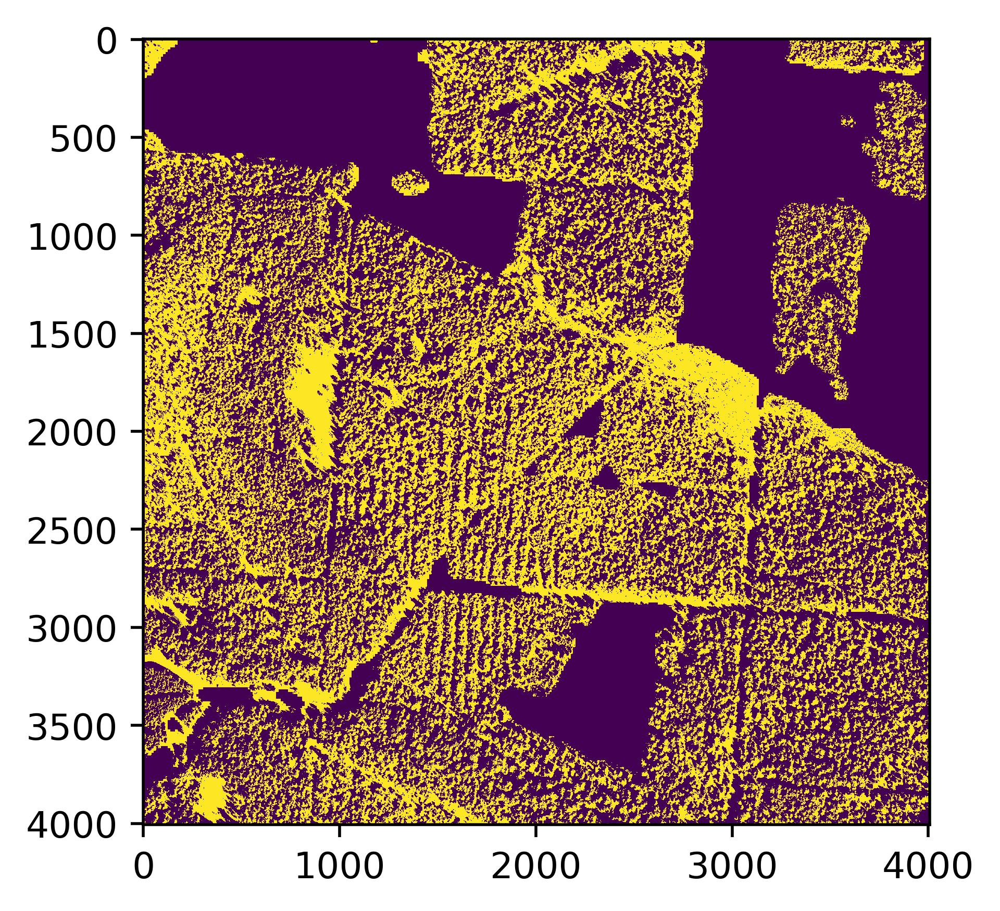

In [27]:
shad[las<1] = 0
plt.imshow(shad)
plt.savefig("fullmask.png")

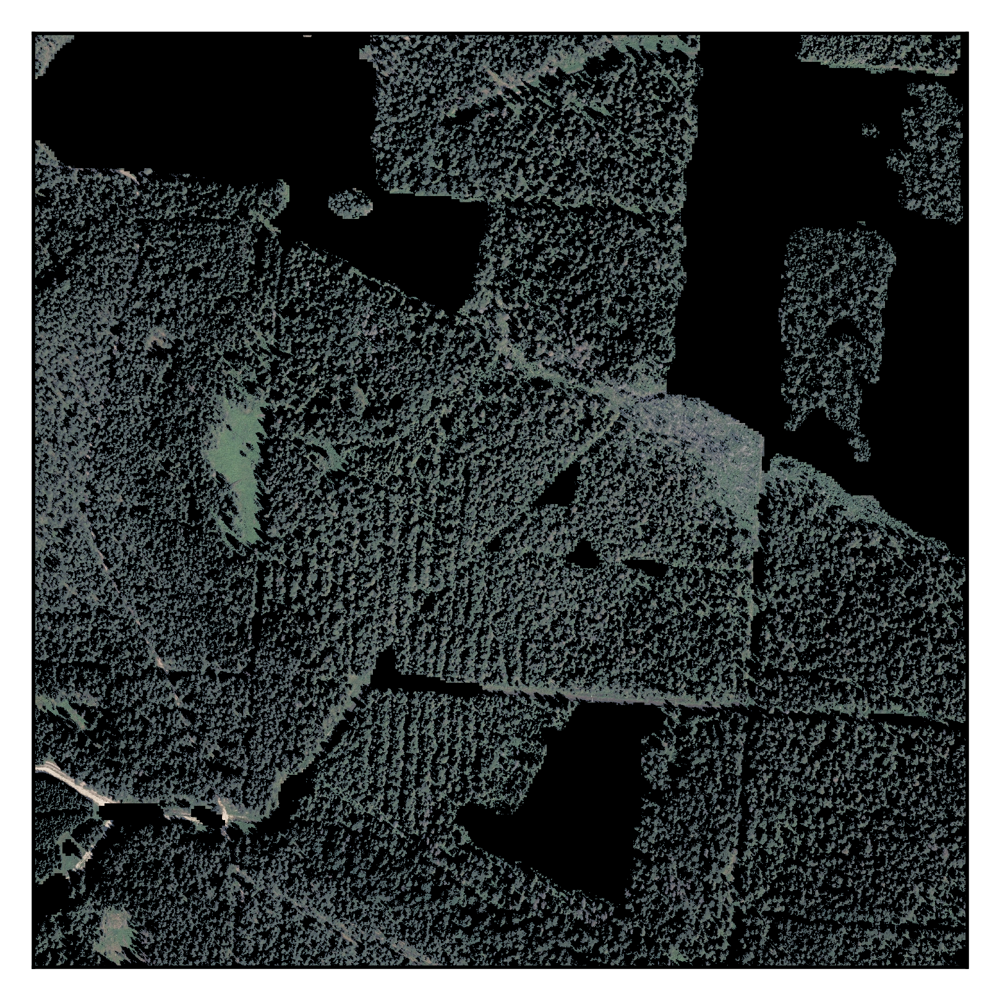

In [30]:
#saving for paper
under = img.copy()
under[shad<1] = 0
fig = plt.imshow(under)
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.savefig("full_mask.png")
